In [32]:
import pandas as pd
from tensorflow.keras.layers import Embedding
from tensorflow.keras.models import Sequential
import tensorflow as tf
import numpy as np
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize, RegexpTokenizer
from nltk.stem import SnowballStemmer

In [33]:
### Descargar stopwords
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\USER\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\USER\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

##### Cargue datos

In [34]:
Df = pd.read_csv("C:/Users/USER/OneDrive - universidadean.edu.co/5. NLP/Repositorio NLP/Actividad 1/reviews_booking.csv")
Df['Calificación'] = Df['Calificación'].astype(str).str.replace(',', '.').astype(float)
Df = Df.drop("Unnamed: 0", axis=1)
Df

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_24060\2155560498.py:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  Df = pd.read_csv("C:/Users/USER/OneDrive - universidadean.edu.co/5. NLP/Repositorio NLP/Actividad 1/reviews_booking.csv")


,País,Acomodación,Noches,Fecha hospedaje,Grupo viaje,Fecha reseña,Titulo,Calificación,Cosas Positivas,Cosas Negativas,reseña
0,Venezuela,NaN,2 noches,julio de 2023,En pareja,31 de julio de 2023,Excepcional,10.0,Fue la Mejor Opción que pudimos haber tomado e...,NaN,Sí
1,Colombia,NaN,4 noches,octubre de 2024,Persona que viaja sola,23 de octubre de 2024,Fantástica,10.0,"Ubicación, comodidades y limpieza",NaN,Sí
2,Colombia,NaN,1 noche,octubre de 2024,Persona que viaja sola,15 de octubre de 2024,Excepcional,10.0,"El lugar esta muy bien ubicado, el apartamento...",NaN,Sí
3,Colombia,NaN,1 noche,agosto de 2024,En pareja,20 de agosto de 2024,Gran apartamento en una gran ubicación.,10.0,Todo estuvo perfecto. La ubicación y la relaci...,NaN,Sí
4,Colombia,NaN,3 noches,marzo de 2024,En pareja,27 de marzo de 2024,Excepcional,10.0,"Es muy cómodo y acogedor, la atención es excel...",NaN,Sí
...,...,...,...,...,...,...,...,...,...,...,...
438208,Estados Unidos,Apartamento Suite,1 noche,septiembre de 2024,En familia,22 de octubre de 2024,Fantástico,9.0,NaN,NaN,No
438209,Colombia,Apartamento de 1 dormitorio,1 noche,octubre de 2024,Persona que viaja sola,9 de octubre de 2024,Excepcional,10.0,NaN,NaN,No
438210,México,Apartamento de 1 dormitorio,4 noches,agosto de 2024,Persona que viaja sola,6 de septiembre de 2024,Pésimo,1.0,No me pareció nada,No obstante que dos días antes de mi llegada a...,Sí
438211,Colombia,Apartamento de 1 dormitorio,2 noches,julio de 2024,En pareja,22 de julio de 2024,Excepcional,10.0,NaN,NaN,No


Corpus Cosas positivas

In [35]:
# Crear una lista de stopwords
stop_words = set(stopwords.words('spanish'))

#Función para contar stopwords en un texto
def count_stopwords(text):
    if not isinstance(text, str):
        return 0
    words = text.split()
    return sum(1 for word in words if word.lower() in stop_words)

# Contar stopwords en la columna 'Cosas Positivas'
stopword_counts = Df['Cosas Positivas'].apply(count_stopwords)

# Filtrar filas con menos de 5 stopwords
Corpus_positivo = Df[stopword_counts >= 15]

# Filtrar filas donde 'Cosas Positivas' tenga más de #### palabra
Corpus_positivo = Corpus_positivo[Corpus_positivo['Cosas Positivas'].str.split().str.len() > 30]

# Filtrar filas donde 'Calificación' sea mayor a 9
Corpus_positivo = Corpus_positivo[Corpus_positivo['Calificación'] > 9]

Corpus_positivo

,País,Acomodación,Noches,Fecha hospedaje,Grupo viaje,Fecha reseña,Titulo,Calificación,Cosas Positivas,Cosas Negativas,reseña
0,Venezuela,NaN,2 noches,julio de 2023,En pareja,31 de julio de 2023,Excepcional,10.0,Fue la Mejor Opción que pudimos haber tomado e...,NaN,Sí
17,Ecuador,NaN,5 noches,octubre de 2024,Persona que viaja sola,29 de octubre de 2024,Excepcional,10.0,Me gusto Poder comprar los alimentos a mi gust...,NaN,Sí
70,Colombia,NaN,1 noche,agosto de 2022,En familia,9 de agosto de 2022,"Maravilloso alojamiento, recomendado!",10.0,"La calidad de personas es maravilloso, desde q...",NaN,Sí
476,Ecuador,NaN,1 noche,agosto de 2024,Persona que viaja sola,26 de agosto de 2024,Excepcional,10.0,La atención como me recibieron es muy buena po...,NaN,Sí
485,Colombia,NaN,2 noches,junio de 2024,En familia,4 de julio de 2024,Un hotel muy agradable,10.0,"El hotel es muy acogedor, está ubicado en una ...",La verdad no hubo nada que no me haya gustado.,Sí
...,...,...,...,...,...,...,...,...,...,...,...
438075,Colombia,Apartamento de 1 dormitorio,5 noches,noviembre de 2024,Persona que viaja sola,10 de noviembre de 2024,Súper,10.0,"El apartamento tiene vista muy bonita, puedes ...",NaN,Sí
438081,Colombia,Habitación Individual,1 noche,junio de 2024,Persona que viaja sola,2 de junio de 2024,Excelente y buen precio,10.0,El mejor hotel boutique en el que me he quedad...,Todo estuvo muy bien.,Sí
438083,Colombia,Habitación Individual,1 noche,junio de 2024,Persona que viaja sola,2 de junio de 2024,Confortable y Conveniente,10.0,"El personal fue amable y atento, la habitación...",NaN,Sí
438170,Colombia,Apartamento de 1 dormitorio,11 noches,julio de 2024,En familia,5 de agosto de 2024,Excelente,10.0,Excelente ubicación con muchos museos y zonas ...,NaN,Sí


##### Preprocesamiento

Normalizacion y tokenizacion

In [36]:
def preprocesar(texto):
    # Convertir a minúsculas
    texto = texto.lower()
    # Eliminar caracteres no alfabéticos y números
    texto = re.sub(r"[\W\d_]+", " ", texto)
    # Crear el tokenizador con expresión regular para palabras
    tokenizer = RegexpTokenizer(r'\w+')
    # Tokenizar el texto y devolverlo como una lista de palabras
    tokens = tokenizer.tokenize(texto)
    return tokens

# Aplicar preprocesamiento a la columna 'Cosas Positivas'
Corpus_positivo = [preprocesar(texto) for texto in Corpus_positivo['Cosas Positivas']]
Corpus_positivo


[['fue',
  'la',
  'mejor',
  'opción',
  'que',
  'pudimos',
  'haber',
  'tomado',
  'en',
  'bogotá',
  'lo',
  'recomendamos',
  'mil',
  'al',
  'regresar',
  'sin',
  'duda',
  'contactaremos',
  'al',
  'anfitrión',
  'porque',
  'fue',
  'todo',
  'un',
  'encanto',
  'limpio',
  'cómodo',
  'cercano',
  'a',
  'todo',
  'súper',
  'seguro',
  'fue',
  'increíble',
  'nuestra',
  'estancia'],
 ['me',
  'gusto',
  'poder',
  'comprar',
  'los',
  'alimentos',
  'a',
  'mi',
  'gusto',
  'ya',
  'que',
  'cuentan',
  'con',
  'lo',
  'basico',
  'como',
  'cocina',
  'nevera',
  'microondas',
  'esta',
  'muy',
  'equipado',
  'el',
  'lugar',
  'es',
  'cómodo',
  'esta',
  'cerca',
  'de',
  'un',
  'centro',
  'comercial',
  'y',
  'cerca',
  'de',
  'la',
  'embajada',
  'de',
  'mexico',
  'me',
  'parecio',
  'perfecto',
  'para',
  'poder',
  'realizar',
  'mis',
  'tramites',
  'la',
  'estadía',
  'es',
  'muy',
  'tranquila',
  'la',
  'recomiendo',
  'esta',
  'ubicado

In [56]:
# Crear un conjunto único de palabras en el corpus
vocab = set(word for sentence in Corpus_positivo for word in sentence)

# Crear un diccionario para mapear palabras a índices
word2idx = {word: idx + 1 for idx, word in enumerate(vocab)}

# Crear un diccionario inverso para mapear índices a palabras
idx2word = {idx: word for word, idx in word2idx.items()}

# Tamaño del vocabulario
vocab_size = len(word2idx)
print(f"Tamaño del vocabulario: {vocab_size}")

# Mostrar el diccionario índice a palabra
idx2word



Tamaño del vocabulario: 13609


{1: 'balanceada',
 2: 'attitude',
 3: 'fizemos',
 4: 'iré',
 5: 'achei',
 6: 'pensión',
 7: 'magnético',
 8: 'chips',
 9: 'disponibilissima',
 10: 'ecuador',
 11: 'serían',
 12: 'occasions',
 13: 'maga',
 14: 'tanto',
 15: 'colchón',
 16: 'traer',
 17: 'forman',
 18: 'decidió',
 19: 'traduce',
 20: 'contratar',
 21: 'budista',
 22: 'possuía',
 23: 'nuestro',
 24: 'jabones',
 25: 'sakudos',
 26: 'policias',
 27: 'usé',
 28: 'problems',
 29: 'aprecia',
 30: 'revoltillo',
 31: 'bogotá',
 32: 'taxy',
 33: 'ganadas',
 34: 'bañarme',
 35: 'molestias',
 36: 'exelencia',
 37: 'medios',
 38: 'antaño',
 39: 'músico',
 40: 'nota',
 41: 'cuantos',
 42: 'acomodaron',
 43: 'teleport',
 44: 'desayunador',
 45: 'teteros',
 46: 'entré',
 47: 'garantir',
 48: 'cargadores',
 49: 'abrió',
 50: 'acabado',
 51: 'magnífico',
 52: 'street',
 53: 'domicilios',
 54: 'itinerario',
 55: 'impresión',
 56: 'ejecutivo',
 57: 'volar',
 58: 'histórico',
 59: 'rencontré',
 60: 'spotty',
 61: 'chaussée',
 62: 'considera

In [43]:
def generate_context(corpus, window_size):
    context_length = 2 * window_size  # Longitud del contexto total
    for words in corpus:
        sentence_length = len(words)  # Longitud de la oración
        for index, word in enumerate(words):
            context_words = []
            start = index - window_size  # Inicio de la ventana
            end = index + window_size + 1  # Fin de la ventana
            # Obtener índices de palabras en el contexto
            context_words.append([word2idx[words[i]]
                                  for i in range(start, end)
                                  if 0 <= i < sentence_length and i != index])
            target_word = word2idx[word]  # Índice de la palabra objetivo
            yield (context_words[0], target_word)  # Devolver contexto y objetivo

# Configurar el tamaño de la ventana
window_size = 4
# Generar los datos de contexto
data = list(generate_context(Corpus_positivo[:3], window_size))
# Mostrar un ejemplo específico
data[3]


([8398, 11287, 3541, 4880, 11708, 4651, 2492], 6335)

In [42]:
print(idx2word[8398])
print(idx2word[11287])
print(idx2word[3541])
print(idx2word[4880])
print(idx2word[11708])
print(idx2word[4651])
print(idx2word[2492])
print("Palabra clave:",idx2word[6335])

fue
la
mejor
que
pudimos
haber
tomado
Palabra clave: opción


In [45]:
X,y=zip(*data)

In [48]:
X=tf.keras.preprocessing.sequence.pad_sequences(X)

# Aumentar el número de columnas que se imprimen
np.set_printoptions(threshold=np.inf, linewidth=np.inf)
print(X)

[[    0     0     0     0 11287  3541  6335  4880]
 [    0     0     0  8398  3541  6335  4880 11708]
 [    0     0  8398 11287  6335  4880 11708  4651]
 [    0  8398 11287  3541  4880 11708  4651  2492]
 [ 8398 11287  3541  6335 11708  4651  2492  6068]
 [11287  3541  6335  4880  4651  2492  6068    31]
 [ 3541  6335  4880 11708  2492  6068    31  9223]
 [ 6335  4880 11708  4651  6068    31  9223 10258]
 [ 4880 11708  4651  2492    31  9223 10258  2756]
 [11708  4651  2492  6068  9223 10258  2756  7473]
 [ 4651  2492  6068    31 10258  2756  7473  1112]
 [ 2492  6068    31  9223  2756  7473  1112  5430]
 [ 6068    31  9223 10258  7473  1112  5430  8996]
 [   31  9223 10258  2756  1112  5430  8996  4053]
 [ 9223 10258  2756  7473  5430  8996  4053  7473]
 [10258  2756  7473  1112  8996  4053  7473  3612]
 [ 2756  7473  1112  5430  4053  7473  3612   975]
 [ 7473  1112  5430  8996  7473  3612   975  8398]
 [ 1112  5430  8996  4053  3612   975  8398  6338]
 [ 5430  8996  4053  7473   975

In [ ]:
print(idx2word[8398])


fue


In [57]:
# Definir el tamaño del vocabulario y la dimensión de las capas densas
vocab_size = len(vocab)  # Número total de palabras únicas en el vocabulario
dimen_densa = 120        # Raiz del Tamaño del vocabulario

# Definir la entrada del modelo
inputs = tf.keras.Input(shape=(window_size * 2,), dtype=tf.int32)
# La entrada será una secuencia de enteros de longitud `window_size*2` (palabras en contexto).

# Capa de embeddings (W)
embedding = tf.keras.layers.Embedding(
    input_dim=vocab_size + 1,   # Tamaño del vocabulario (+1 por si hay padding)
    output_dim=dimen_densa,    # Dimensión de los vectores de embedding
    input_length=window_size * 2  # Longitud de la entrada (contexto)
)(inputs)
# Transforma cada entero (palabra) en un vector denso de dimensión `dimen_densa`.

# Promediar los vectores del embedding (reduce_mean)
mean_embedding = tf.keras.layers.Lambda(lambda x: tf.reduce_mean(x, axis=1))(embedding)
# Calcula el promedio de los vectores de embedding a lo largo de las palabras en el contexto.
# Esto genera un único vector que resume toda la secuencia de entrada.

# Capa de salida (U)
outputs = tf.keras.layers.Dense(
    vocab_size + 1,  # Número de neuronas igual al tamaño del vocabulario (+1)
    activation='softmax'  # Activación softmax para obtener probabilidades
)(mean_embedding)
# Predice la probabilidad de cada palabra del vocabulario (dada la entrada promedio).

# Crear el modelo
model = tf.keras.Model(inputs=inputs, outputs=outputs)
# Define el modelo con las entradas y las salidas especificadas.

# Compilar el modelo
model.compile(
    optimizer='adam',  # Optimizador Adam (común para NLP y redes neuronales)
    loss='sparse_categorical_crossentropy'  # Pérdida categórica para clasificación
)
# Configura el modelo para entrenar, utilizando la función de pérdida y el optimizador.

# Mostrar un resumen del modelo
model.summary()
# Muestra la estructura del modelo, incluyendo el número de capas y parámetros.



c:\Users\USER\miniconda3\envs\entorno_npl_ean_py3.10\lib\site-packages\keras\src\layers\core\embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 8)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding (Embedding)           │ (None, 8, 120)         │     1,633,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lambda (Lambda)                 │ (None, 120)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 13610)          │     1,646,810 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,280,010 (12.51 MB)

 Trainable params: 3,280,010 (12.51 MB)

 Non-trainable params: 0 (0.00 B)

In [63]:
model.fit(np.array(X),np.array(y),epochs=100, verbose=2)

Epoch 1/100
6/6 - 0s - 27ms/step - loss: 0.1172
Epoch 2/100
6/6 - 0s - 25ms/step - loss: 0.1162
Epoch 3/100
6/6 - 0s - 25ms/step - loss: 0.1153
Epoch 4/100
6/6 - 0s - 27ms/step - loss: 0.1144
Epoch 5/100
6/6 - 0s - 28ms/step - loss: 0.1134
Epoch 6/100
6/6 - 0s - 29ms/step - loss: 0.1126
Epoch 7/100
6/6 - 0s - 30ms/step - loss: 0.1117
Epoch 8/100
6/6 - 0s - 30ms/step - loss: 0.1109
Epoch 9/100
6/6 - 0s - 32ms/step - loss: 0.1097
Epoch 10/100
6/6 - 0s - 30ms/step - loss: 0.1090
Epoch 11/100
6/6 - 0s - 29ms/step - loss: 0.1081
Epoch 12/100
6/6 - 0s - 29ms/step - loss: 0.1074
Epoch 13/100
6/6 - 0s - 29ms/step - loss: 0.1065
Epoch 14/100
6/6 - 0s - 28ms/step - loss: 0.1056
Epoch 15/100
6/6 - 0s - 29ms/step - loss: 0.1048
Epoch 16/100
6/6 - 0s - 30ms/step - loss: 0.1039
Epoch 17/100
6/6 - 0s - 29ms/step - loss: 0.1032
Epoch 18/100
6/6 - 0s - 29ms/step - loss: 0.1024
Epoch 19/100
6/6 - 0s - 29ms/step - loss: 0.1017
Epoch 20/100
6/6 - 0s - 29ms/step - loss: 0.1007
Epoch 21/100
6/6 - 0s - 30ms/

In [66]:
word_vectors=model.get_layer('embedding')

In [67]:
word_vectors.get_weights()[0]

array([[ 5.06091893e-01,  3.27552199e-01,  6.02248669e-01,  2.57714987e+00,  3.15577579e+00,  9.51623082e-01,  3.72391753e-02,  5.93071461e-01,  1.50135428e-01,  1.05483806e+00,  1.02636862e+00,  2.03579426e+00, -8.00064623e-01,  7.27413893e-01,  5.29558718e-01, -9.58058298e-01,  2.09967232e+00, -4.33478951e-02,  6.09431207e-01, -5.61011612e-01,  1.43089950e+00,  1.14385724e+00,  1.53183198e+00,  1.52093732e+00,  9.67998087e-01, -1.24140823e+00,  2.35103750e+00,  2.07763672e+00, -6.16934597e-01,  7.14530051e-01,  7.42353439e-01, -2.29502940e+00,  1.62961185e+00, -1.01696618e-01, -1.14616168e+00,  7.73221374e-01, -1.40678108e+00, -5.30782402e-01,  3.05346072e-01,  7.75189102e-01, -2.17014790e-01, -2.16158891e+00,  1.17335582e+00, -9.78208005e-01,  6.12330437e-01,  1.41247559e+00,  6.24615312e-01, -2.63206959e+00, -1.74436235e+00, -6.82705522e-01,  6.97677016e-01,  5.90174422e-02,  9.34945822e-01,  4.91155744e-01, -2.01328087e+00, -4.16203737e-01, -9.65659440e-01,  1.95475388e+00, -1.459

Preguntas
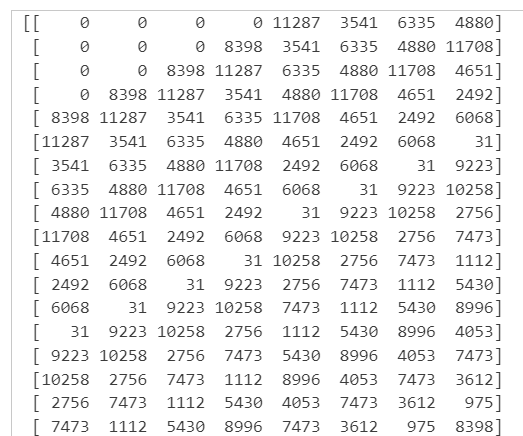

Observacion extrañan de patrones
Como le hago entender que es positivo o negativos